In [5]:
import folium
import hdbscan
import itertools
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy.cluster.hierarchy as spc
import seaborn as sns
import umap

from sklearn.preprocessing import MinMaxScaler
from tqdm import tqdm

%matplotlib inline
plt.style.use('seaborn-poster')

/usr/local/lib/python3.7/site-packages/sklearn/externals/six.py:31: DeprecationWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", DeprecationWarning)
/usr/local/lib/python3.7/site-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


## Load the epi data

#### Load and wrangle the IHME data

In [6]:
df_ihme = pd.read_csv("Brazil_data - ihme.csv")

In [7]:
df_ihme['location_name'] = df_ihme['location_name'].replace(to_replace={
        'Piaui': 'Piauí',
        'Distrito Federal': 'Federal District'
    }
)

In [8]:
# drop non-useful columns

df_ihme = df_ihme.drop([
    'location_id',
    'sex_id',
    'year_id',
    'measure_id',
    'measure_name',
    'metric_name',
    'upper',
    'lower',
], axis=1)

In [9]:
# some column headers are unwiedly, rename these

rename_columns = {
    'Proportion of the population considered current smokers (currently use any smoked tobacco product on a daily or occasional basis)': 'proportion_current_smokers',
    'Proportion of the population with unsafe water exposure, unimproved & untreated (mean value directly from IHME)': 'proportion_unsafe_water',
    'Proportion of the population with unsafe sanitation exposure, unimproved & untreated (mean value directly from IHME)': 'proportion_unsafe_sanitation',
    'Physical activity represented by Metabolic Equivalent, METs (ratio of the working metabolic rate to the resting metabolic rate; one MET is equivalent to 1 kcal/kg/hour) (mean average value directly from IHME)': 'MET',
    'Proportion of the population exposed to household air pollution from solid fuels (mean value directly from IHME)': 'proportion_solid_fuels',
    'Daily alcohol consumption in current drinkers, per day over a 12-month period (mean average value g/day directly from IHME)': 'alcohol',
    'High blood pressure measured through brachial systolic blood pressure level (mean average value mmHg directly from IHME)': 'blood_pressure',
    'High body-mass index level (obesity defined as a BMI greater than 20 to 25 kg/m2 for adults) (mean value directly from IHME)': 'high_BMI',
    'High cholesterol measured through blood concentration of low-density lipoprotein (LDL) in units of mmol/L (mean average value directly from IHME)': 'high_cholesterol',
    'Proportion of the population exposed to high occupational particulate matter, gases and fumes (mean value directly from IHME)': 'proportion_particulate_matter',
}

df_ihme = df_ihme.rename(columns=rename_columns)

In [10]:
# convert a few string columns to numeric columns

non_numeric_cols = ['MET','Population']

for col in non_numeric_cols:
    df_ihme[col] = df_ihme[col].str.replace(",","").astype(float)

In [11]:
# some age groups have a lot of missing data - easiest to just remove these age groups

remove_ages = [
    'Birth',
    'Neonatal',
    'Early Neonatal',
    'Late Neonatal',
    'Post Neonatal',
    '1 to 4',
    '5 to 9',
    '10 to 14',
    '15 to 19',
    '20 to 24'
]

df_ihme = df_ihme.loc[~df_ihme['age_group_name'].isin(remove_ages)]

In [12]:
df_ihme_temp = df_ihme.copy()

# sum up the total population of all age groups and both sexes for each state
total_populations = df_ihme[['Population','location_name']].groupby('location_name').sum().reset_index()

# identify the numeric position of the first feature column
first_feature_col = df_ihme_temp.columns.tolist().index('proportion_current_smokers')
feature_columns = df_ihme.columns[first_feature_col:].tolist()

# for each feature, multiple the value by the age-sex population
for col_num in range(first_feature_col, df_ihme_temp.shape[1]):
    df_ihme_temp.iloc[:,col_num] = df_ihme_temp.iloc[:,col_num].values * df_ihme_temp['Population'].values

# for each feature, add up all of these values across age-sex.
df_ihme_temp = df_ihme_temp[['location_name']+feature_columns].groupby('location_name').sum()

# put the overall population back in the table
df_ihme_temp = pd.merge(
    total_populations,
    df_ihme_temp,
    how='left',
    on='location_name'
)

# For each feature row, divide it by the total population of that state
first_feature_col = df_ihme_temp.columns.tolist().index('proportion_current_smokers')
for col_num in range(first_feature_col, df_ihme_temp.shape[1]):
    df_ihme_temp.iloc[:,col_num] = df_ihme_temp.iloc[:,col_num].values / df_ihme_temp['Population'].values
    
df_ihme = df_ihme_temp.drop('Population', axis=1)


In [13]:
df_ihme.head()

,location_name,proportion_current_smokers,proportion_unsafe_water,proportion_unsafe_sanitation,MET,proportion_solid_fuels,alcohol,blood_pressure,high_BMI,high_cholesterol,proportion_particulate_matter
0,Acre,0.106185,0.08,0.27,2986.176002,0.06,10.493302,124.067593,26.802656,3.269752,0.034353
1,Alagoas,0.082279,0.06,0.29,3160.051642,0.09,10.531872,126.700573,26.269634,3.252544,0.038953
2,Amapá,0.093087,0.02,0.30,2781.934767,0.02,10.273018,123.405567,27.079233,3.286661,0.039938
3,Amazonas,0.082676,0.05,0.23,2936.011260,0.05,10.090194,122.569856,27.084091,3.287151,0.048787
4,Bahia,0.069164,0.04,0.21,2773.788306,0.09,10.790684,128.240931,26.165308,3.287938,0.039085


#### Load the non-IHME data

In [14]:
df_non_ihme = pd.read_csv("brazil_only.csv")

In [15]:
df_non_ihme = df_non_ihme.set_index('Location')

In [16]:
df_non_ihme = df_non_ihme.rename(
    index={
        'Piaui': 'Piauí',
        'Distrito Federal (Brazil)': 'Federal District'
    }
)

In [17]:
df_non_ihme = df_non_ihme.reset_index()

In [18]:
df_non_ihme.head()

,Location,Cardiovascular diseases,Chronic respiratory diseases,Diabetes and kidney diseases,Digestive diseases,Enteric infections,HIV/AIDS and sexually transmitted infections,Maternal and neonatal disorders,Mental disorders,Musculoskeletal disorders,...,Respiratory infections and tuberculosis,Self-harm and interpersonal violence,Skin and subcutaneous diseases,Substance use disorders,Transport injuries,Unintentional injuries,HAQ,SDI,<15 years of age (%),65/+ years of age (%)
0,Acre,0.004800,0.011003,0.004004,0.068942,0.730632,0.124143,0.010474,0.046250,0.051343,...,2.429348,0.002919,0.577712,0.014192,0.005883,0.069492,57.2,0.601605,0.293726,0.049656
1,Alagoas,0.006007,0.010377,0.005232,0.067157,0.699541,0.119081,0.006782,0.050714,0.053497,...,2.387096,0.002677,0.596925,0.014082,0.004018,0.034665,56.6,0.555715,0.276556,0.070042
2,Amapá,0.004467,0.010780,0.003864,0.064370,0.425502,0.129626,0.009149,0.047060,0.049957,...,2.418611,0.004189,0.566104,0.013853,0.006934,0.030991,60.3,0.658518,0.283351,0.041355
3,Amazonas,0.004739,0.011281,0.003998,0.064854,0.514823,0.128361,0.006417,0.044232,0.051019,...,2.422199,0.002663,0.582953,0.013481,0.003283,0.032780,60.4,0.629316,0.297554,0.048309
4,Bahia,0.006912,0.010917,0.005280,0.073244,0.816268,0.119973,0.006276,0.043988,0.055984,...,2.350070,0.003351,0.616163,0.015924,0.003677,0.037676,58.8,0.591020,0.251612,0.083347


In [19]:
# df_data.columns.tolist()

#### Join the two datasets

In [20]:
df_data = pd.merge(
    df_non_ihme,
    df_ihme,
    how='outer',
    left_on='Location',
    right_on='location_name'
).drop('location_name', axis=1).set_index('Location')

In [21]:
df_data

,Cardiovascular diseases,Chronic respiratory diseases,Diabetes and kidney diseases,Digestive diseases,Enteric infections,HIV/AIDS and sexually transmitted infections,Maternal and neonatal disorders,Mental disorders,Musculoskeletal disorders,Neglected tropical diseases and malaria,...,proportion_current_smokers,proportion_unsafe_water,proportion_unsafe_sanitation,MET,proportion_solid_fuels,alcohol,blood_pressure,high_BMI,high_cholesterol,proportion_particulate_matter
Location,,,,,,,,,,,,,,,,,,,,,
Acre,0.004800,0.011003,0.004004,0.068942,0.730632,0.124143,0.010474,0.046250,0.051343,0.053561,...,0.106185,0.08,0.27,2986.176002,0.06,10.493302,124.067593,26.802656,3.269752,0.034353
Alagoas,0.006007,0.010377,0.005232,0.067157,0.699541,0.119081,0.006782,0.050714,0.053497,0.036375,...,0.082279,0.06,0.29,3160.051642,0.09,10.531872,126.700573,26.269634,3.252544,0.038953
Amapá,0.004467,0.010780,0.003864,0.064370,0.425502,0.129626,0.009149,0.047060,0.049957,0.053243,...,0.093087,0.02,0.30,2781.934767,0.02,10.273018,123.405567,27.079233,3.286661,0.039938
Amazonas,0.004739,0.011281,0.003998,0.064854,0.514823,0.128361,0.006417,0.044232,0.051019,0.044177,...,0.082676,0.05,0.23,2936.011260,0.05,10.090194,122.569856,27.084091,3.287151,0.048787
Bahia,0.006912,0.010917,0.005280,0.073244,0.816268,0.119973,0.006276,0.043988,0.055984,0.026678,...,0.069164,0.04,0.21,2773.788306,0.09,10.790684,128.240931,26.165308,3.287938,0.039085
Ceará,0.006627,0.010515,0.004598,0.070411,0.727063,0.121365,0.007682,0.050061,0.055698,0.029815,...,0.081661,0.05,0.25,2847.331390,0.09,10.721171,126.485327,26.541774,3.298358,0.042844
Federal District,0.005922,0.010699,0.004503,0.076609,0.363382,0.131345,0.006709,0.048700,0.058297,0.019442,...,0.102944,0.00,0.03,2513.474490,0.00,10.601874,124.054528,28.803471,3.478361,0.028850
Espírito Santo,0.007244,0.011141,0.005564,0.077302,0.516810,0.123510,0.005206,0.049645,0.059064,0.031623,...,0.097135,0.02,0.08,2861.177613,0.06,10.758510,126.849920,26.560878,3.374189,0.041981
Goiás,0.006630,0.010583,0.004805,0.080238,0.606551,0.127963,0.005034,0.052081,0.059174,0.033310,...,0.104903,0.02,0.16,2884.730416,0.04,10.702127,126.540676,26.390451,3.341185,0.038409


## Scale each feature so that UMAP doesn't bias towards features with a greater magnitude

In [22]:
scaler = MinMaxScaler()
df_scaled = df_data.copy()
df_scaled.iloc[:,:] = scaler.fit_transform(df_scaled)

## Fit UMAP over boostrapped samples of features

### Specify model parameters

In [19]:
n_iterations = 1000

# Specify the model parameters
fit = umap.UMAP(
    n_neighbors=5,
    min_dist=0.1,
    n_components=2,
    metric='euclidean'
)

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=int(np.round(len(df_data) / 10)), 
    min_samples=1
)

#set a few variables
state_pair_table = []
feature_table = []
label_array = np.full(shape=(len(df_data),n_iterations), fill_value=np.nan)
n_cols = df_scaled.shape[1] - 1

### Run iterations of UMAP with bootstrapped features

In [20]:
for i in tqdm(range(n_iterations)):
    
    #subselect features
    random_features = np.random.choice(
        n_cols, 
        n_cols, 
        replace=True
    ) + 1
    
    #fit the umap model
    u = fit.fit_transform(df_scaled.iloc[:,random_features])
    
    #cluster the umap reduced data
    clusterer.fit(u)
    label_array[:,i] = clusterer.labels_
    
    #save the features used to a table
    unique_features, feature_counts = np.unique(random_features, return_counts=True)
    for u in range(len(unique_features)):
        feature_table += [
            {
                "iteration": i,
                "feature_name": df_scaled.columns[unique_features[u]],
                "feature_count": feature_counts[u],

            }
        ]
    
    #save the state pairs to a table
    for c in np.unique(clusterer.labels_):
        for pair in list(itertools.combinations(df_scaled.iloc[clusterer.labels_ == c,0],2)):

            state_pair_table += [{
                "iteration": i,
                "state_1": pair[0],
                "state_2": pair[1],
                "cluster_number": c,
                "total_clusters": len(clusterer.labels_),
            }]
            


100%|██████████| 1000/1000 [00:35<00:00, 28.20it/s]


### Identify how many times each pair of states were clustered together across the iterations

In [21]:
it_clusters = []
for c in tqdm(range(label_array.shape[1])):
    clusters = []
    non_cluster = []
    for l in np.unique(label_array[:,0]):
        if l == -1:
            non_cluster = df_data.index.values[label_array[:,c]==l].tolist()
        else:
            clusters += [df_data.index.values[label_array[:,c]==l].tolist()]
        
    it_clusters += [[non_cluster, clusters]]
    

df_cluster_count = pd.DataFrame(np.full(shape=(len(df_data),len(df_data)), fill_value=0))
df_cluster_count.index = df_data.index.values
df_cluster_count.columns = df_data.index.values

for ic in tqdm(it_clusters):
    for c in range(len(ic[1])):
        all_pairs = list(itertools.combinations(ic[1][c],2))
        for p in all_pairs:
            df_cluster_count.loc[p[0],p[1]] += 1
            df_cluster_count.loc[p[1],p[0]] += 1

100%|██████████| 1000/1000 [01:00<00:00, 16.58it/s]


### Plot the heatmap showing the count of the number of times two states were clustered together

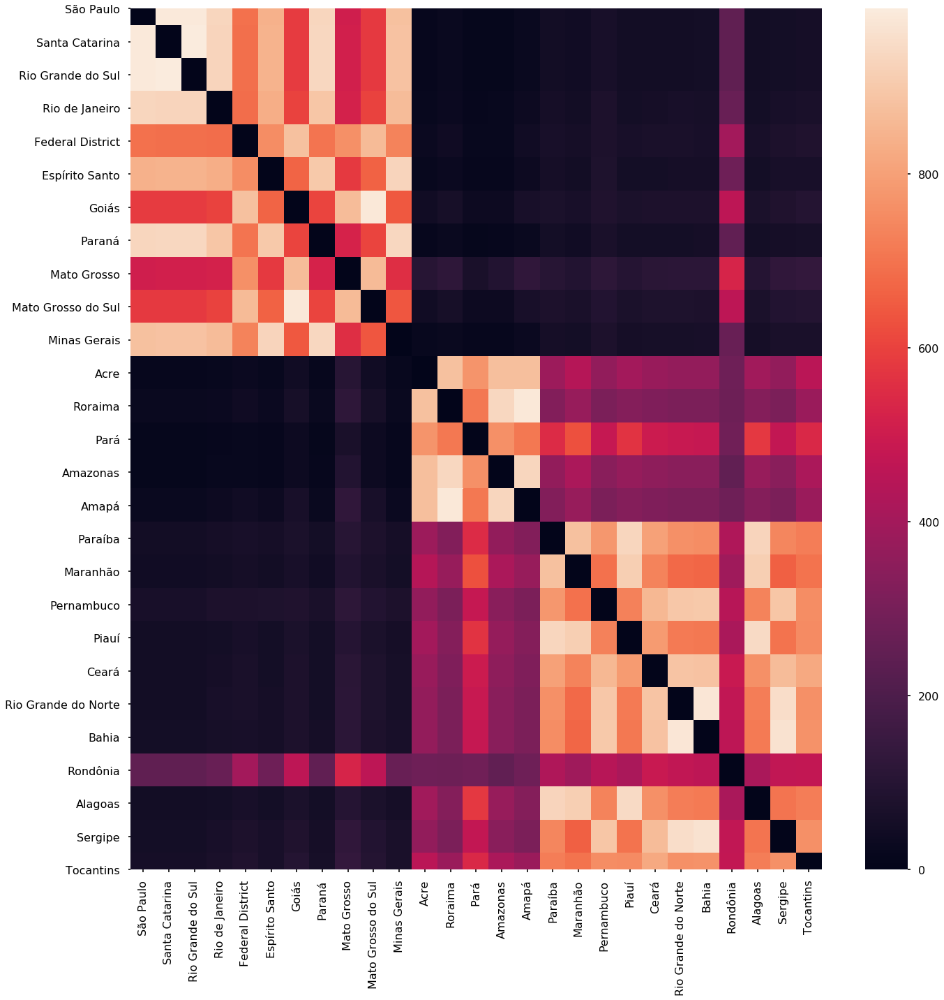

In [22]:
pdist = spc.distance.pdist(df_cluster_count)
linkage = spc.linkage(pdist, method='complete')
idx = spc.fcluster(linkage, 0.5 * pdist.max(), 'distance')
new_order = np.argsort(idx)
plt.figure(figsize=(20,20))
sns.heatmap(df_cluster_count.iloc[new_order,new_order]);

plt.tight_layout()
plt.savefig('state_pair_count.png',quality=90,transparent=True)
plt.show()

## Another round UMAP to identify clusters based on the number of times that regions were clustered together

### Set the umap and HDBSCAN parameters

In [23]:
fit2 = umap.UMAP(
    n_neighbors=5,
    min_dist=0.1,
    n_components=2,
    metric='euclidean'
)

clusterer2 = hdbscan.HDBSCAN(
    min_cluster_size=5, 
    min_samples=1
)

### Fit umap and hdbscan

In [24]:
u2 = fit2.fit_transform(df_cluster_count.iloc[:,1:])

clusterer2.fit(u2);

df_labelled = df_cluster_count.copy()
df_labelled["u0"] = u2[:,0]
df_labelled["u1"] = u2[:,1]
df_labelled['label'] = clusterer2.labels_
df_labelled['label'] = df_labelled['label'] + 1
df_labelled = df_labelled[['label','u0','u1']]
df_labelled = df_labelled.sort_values('label')

/usr/local/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


### Plot a scatter plot with the different clusters

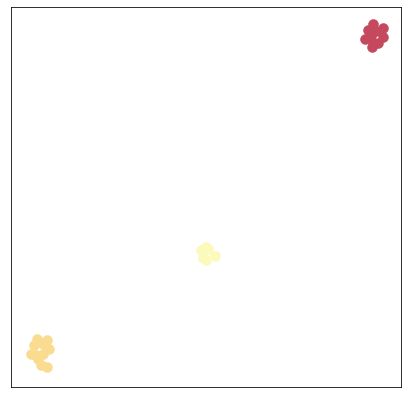

In [25]:
# colors = ['red','green','blue','purple','orange','black','brown','magenta','cyan']
colors = ['#fbfabb', '#fadc90', '#f8a26c', '#ee6b5d', '#c5495e']

plt.figure(figsize=(7,7))
for l in df_labelled['label'].unique():
    df_temp = df_labelled[df_labelled['label'] == l]
    plt.scatter(
        df_temp["u0"],
        df_temp["u1"],
        c=colors[l-2],
        s=100
    )
    plt.xticks([])
    plt.yticks([])

#     for i in range(len(df_temp)):
#         plt.annotate(
#             df_temp.index[i], 
#             (df_temp["u0"].iloc[i], df_temp["u1"].iloc[i]),
#             fontsize=15,
#         )
#         break

plt.savefig('state_clusters.png',quality=90,transparent=True)
plt.show()

## Plot a choropleth map

In [26]:
#join the data to the latlon table that has the state abbreviations
#the json used abbreviations, which is what we join the data with

df_labelled_mapplot = df_labelled.copy()
df_labelled_mapplot = df_labelled_mapplot.rename(
    index={
        'Piaui': 'Piauí',
        'Distrito Federal (Brazil)': 'Federal District'
    }
)
df_labelled_mapplot = df_labelled_mapplot.reset_index()
df_labelled_mapplot.columns = ['name', 'label', 'u0', 'u1']



#make the map
m = folium.Map(location=[-20, -55], zoom_start=3)
folium.Choropleth(
    geo_data="brasilian_27_states.GeoJson",
    name='choropleth',
    data=df_labelled_mapplot,
    columns=['name', 'label'],
    key_on='feature.properties.name',
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Cluster'
).add_to(m)
folium.GeoJson(
    "brasilian_5_regions.GeoJson",
    name='geojson'
).add_to(m)
folium.LayerControl().add_to(m)

m

## Identify sentinel states

the sentinel is defined as the state with the highest cumulative correlation with other states

In [115]:
df_cluster_count.head()

,Acre,Alagoas,Amapá,Amazonas,Bahia,Ceará,Federal District,Espírito Santo,Goiás,Maranhão,...,Piauí,Rio de Janeiro,Rio Grande do Norte,Rio Grande do Sul,Rondônia,Roraima,Santa Catarina,São Paulo,Sergipe,Tocantins
Acre,0,3505,7627,7650,3429,3455,291,201,401,3896,...,3484,204,3430,172,2337,7664,172,172,3425,3879
Alagoas,3505,0,3074,3402,5515,5586,592,549,673,5861,...,6005,574,5531,516,3026,3091,516,516,5433,5295
Amapá,7627,3074,0,8097,3025,3037,391,284,556,3470,...,3056,279,3025,248,2398,8505,248,248,3038,3445
Amazonas,7650,3402,8097,0,3335,3352,219,148,308,3810,...,3374,155,3337,121,2189,8120,121,121,3352,3778
Bahia,3429,5515,3025,3335,0,5818,605,561,688,5324,...,5510,591,5946,527,3048,3043,527,527,5885,5347


In [27]:
manual_clusters = [
    [
        "Acre",
        "Roraima",
        "Pará",
        "Amazonas",
        "Amapá",
        "Rondônia",
    ],
    [
        "Sergipe",
        "Pernambuco",
        "Piauí",
        "Maranhão",
        "Rio Grande do Norte",
        "Ceará",
        "Bahia",
        "Alagoas",
        "Paraíba", 
        "Tocantins",
    ],
    [
        "São Paulo", 
        "Santa Catarina", 
        "Rio Grande do Sul", 
        "Federal District", 
        "Espírito Santo", 
        "Goiás", 
        "Rio de Janeiro", 
        "Mato Grosso", 
        "Mato Grosso do Sul", 
        "ParanáSão Paulo", 
        "Santa Catarina", 
        "Rio Grande do Sul", 
        "Distrito Federal", 
        "Espírito Santo", 
        "Goiás", 
        "Rio de Janeiro", 
        "Mato Grosso", 
        "Mato Grosso do Sul", 
        "Paraná",
    ]
]

In [124]:
# manual_clusters = [
#     [
#         "Acre",
#         "Roraima",
#         "Pará",
#         "Amazonas",
#         "Amapá",
#         "Sergipe",
#         "Pernambuco",
#         "Piauí",
#         "Maranhão",
#         "Rio Grande do Norte",
#         "Ceará",
#         "Bahia",
#         "Alagoas",
#         "Paraíba", 
#         "Tocantins",
#         "Rondônia",
#     ],
#     [
#         "São Paulo", 
#         "Santa Catarina", 
#         "Rio Grande do Sul", 
#         "Federal District", 
#         "Espírito Santo", 
#         "Goiás", 
#         "Rio de Janeiro", 
#         "Mato Grosso", 
#         "Mato Grosso do Sul", 
#         "ParanáSão Paulo", 
#         "Santa Catarina", 
#         "Rio Grande do Sul", 
#         "Distrito Federal", 
#         "Espírito Santo", 
#         "Goiás", 
#         "Rio de Janeiro", 
#         "Mato Grosso", 
#         "Mato Grosso do Sul", 
#         "Paraná",
#     ]
# ]

In [28]:
cluster_sentinels = []
for cluster in manual_clusters:
    
    temp_cluster_count = df_cluster_count.loc[
        df_cluster_count.index.isin(cluster),
        df_cluster_count.columns.isin(cluster),
    ]
    
    sentinel_ranking = temp_cluster_count.sum().sort_values(ascending=False)
    relative_sentinel_ranking = sentinel_ranking / sentinel_ranking.max()
    
    cluster_sentinels += [[relative_sentinel_ranking]]

In [29]:
for c in cluster_sentinels:
    print(c)
    print(" ")

[Roraima     1.000000
Amapá       0.999207
Amazonas    0.992867
Acre        0.972523
Pará        0.854161
Rondônia    0.361691
dtype: float64]
 
[Ceará                  1.000000
Rio Grande do Norte    0.992568
Bahia                  0.992568
Paraíba                0.987162
Sergipe                0.978784
Pernambuco             0.977432
Piauí                  0.970811
Alagoas                0.965946
Maranhão               0.924324
Tocantins              0.915000
dtype: float64]
 
[Santa Catarina        1.000000
Rio Grande do Sul     1.000000
São Paulo             0.999149
Paraná                0.997874
Espírito Santo        0.983697
Rio de Janeiro        0.981854
Federal District      0.953785
Goiás                 0.901191
Mato Grosso do Sul    0.896796
Mato Grosso           0.802240
dtype: float64]
 


### For each feature, plot the cluster averages

In [60]:
state_lists = []
for l in df_labelled['label'].unique():
    state_lists += [df_labelled.loc[df_labelled['label']==l].index.tolist()]
    
representative_states = [s[0] for s in state_lists]


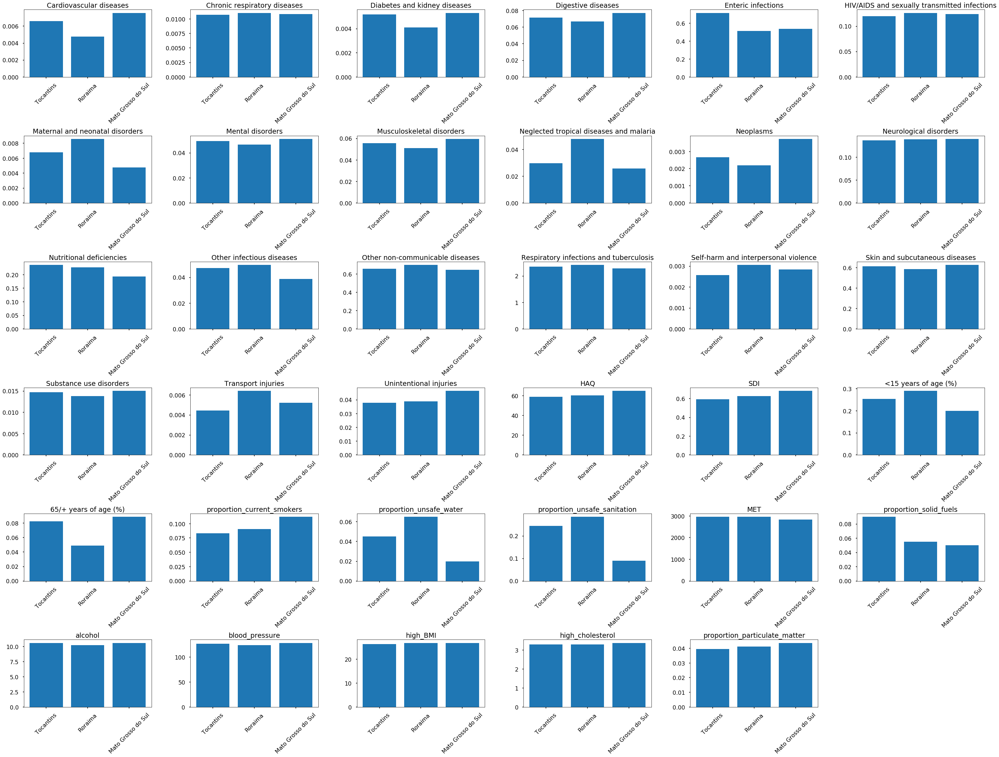

In [68]:
plt.figure(figsize=(40,30))
for i in range(0,df_data.shape[1]):
    
    data_medians = []
    for s in state_lists:
        data_medians += [df_data.loc[s].iloc[:,i].median()]
        
    plt.subplot(6,6,i+1)
    plt.bar(
        x=(range(1,len(state_lists)+1)),
        height=data_medians,
    )
    
    plt.xticks(
        (range(1,len(state_lists)+1)),
        representative_states,
        rotation=45
    )

    
    plt.title(df_data.columns[i])

plt.tight_layout()
plt.savefig('regional_differences_per_feature.png', quality=90, transparent=False)
plt.show()
        
   

In [53]:
data_medians

[0.03953259562997219, 0.04109629685583041, 0.04372882877357951]

In [51]:
df_data.loc[s].iloc[

,Cardiovascular diseases,Chronic respiratory diseases,Diabetes and kidney diseases,Digestive diseases,Enteric infections,HIV/AIDS and sexually transmitted infections,Maternal and neonatal disorders,Mental disorders,Musculoskeletal disorders,Neglected tropical diseases and malaria,...,proportion_current_smokers,proportion_unsafe_water,proportion_unsafe_sanitation,MET,proportion_solid_fuels,alcohol,blood_pressure,high_BMI,high_cholesterol,proportion_particulate_matter
Location,,,,,,,,,,,,,,,,,,,,,
Roraima,0.004491,0.011488,0.004421,0.063267,0.514259,0.124332,0.009749,0.052731,0.050691,0.051622,...,0.087921,0.02,0.27,3066.008609,0.03,10.531565,123.565556,26.862963,3.283616,0.045177
Rondônia,0.005778,0.010161,0.004811,0.075333,0.512167,0.128687,0.006294,0.049098,0.056642,0.039414,...,0.103285,0.08,0.35,2739.635487,0.09,10.218415,123.802739,26.768166,3.300790,0.040001
Acre,0.004800,0.011003,0.004004,0.068942,0.730632,0.124143,0.010474,0.046250,0.051343,0.053561,...,0.106185,0.08,0.27,2986.176002,0.06,10.493302,124.067593,26.802656,3.269752,0.034353
Amazonas,0.004739,0.011281,0.003998,0.064854,0.514823,0.128361,0.006417,0.044232,0.051019,0.044177,...,0.082676,0.05,0.23,2936.011260,0.05,10.090194,122.569856,27.084091,3.287151,0.048787
Amapá,0.004467,0.010780,0.003864,0.064370,0.425502,0.129626,0.009149,0.047060,0.049957,0.053243,...,0.093087,0.02,0.30,2781.934767,0.02,10.273018,123.405567,27.079233,3.286661,0.039938
Pará,0.005086,0.011105,0.004209,0.070285,0.925256,0.121133,0.008034,0.041345,0.051605,0.030432,...,0.087011,0.10,0.32,3119.978464,0.08,9.830660,124.276795,26.485964,3.247301,0.042191


In [49]:
df_data.shape[1]

35

## Plot all states within a cluster on feature scale

In [34]:
cluster_number = 3

state_list = df_labelled.loc[df_labelled['label']==cluster_number].index.tolist()

In [35]:
sorted(state_list)

['Espírito Santo',
 'Federal District',
 'Goiás',
 'Mato Grosso',
 'Mato Grosso do Sul',
 'Minas Gerais',
 'Paraná',
 'Rio Grande do Sul',
 'Rio de Janeiro',
 'Santa Catarina',
 'São Paulo']

In [36]:
printable_columns = []
for i in df_data.columns:
    i = i.replace("_", " ")
    if len(i) > 20:
        i = i.replace("_", " ")
        words = i.split(" ")
        wc = 0
        new_words = []
        for w in words:
            wc += 1
            if wc > 2:
                new_words += ["\n"]
                wc = 0
            new_words += [w]
        
        printable_columns += [" ".join(new_words)]
        
    else:
        printable_columns += [i]

['Mato Grosso do Sul', 'Mato Grosso', 'Paraná', 'Goiás', 'Espírito Santo', 'Rio de Janeiro', 'Federal District', 'Rio Grande do Sul', 'Santa Catarina', 'São Paulo', 'Minas Gerais']


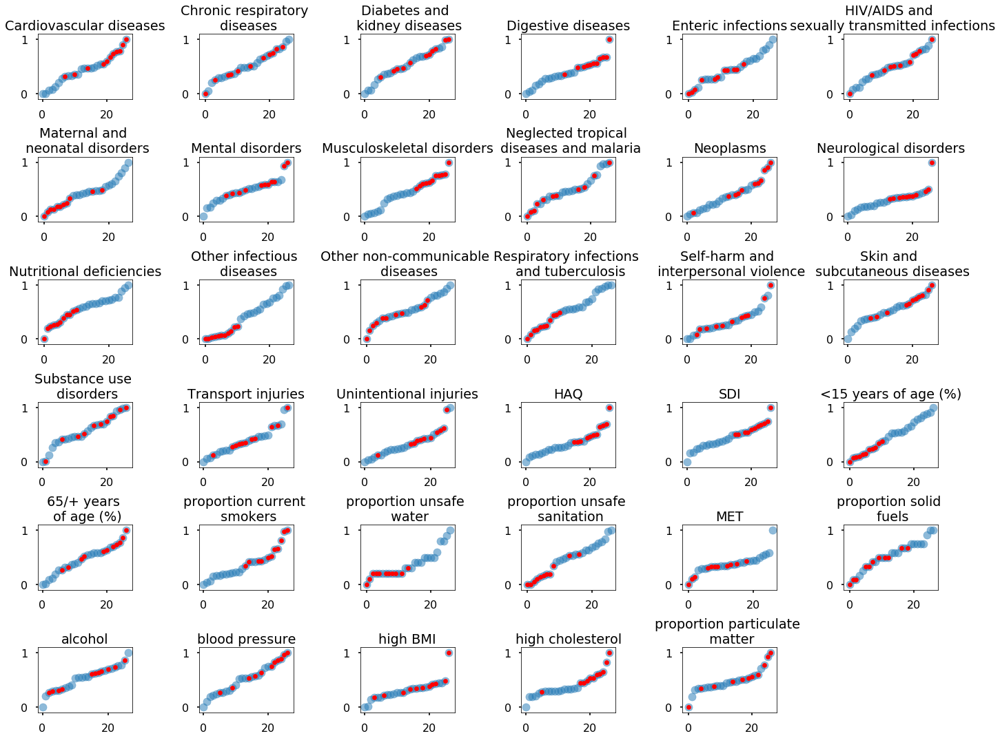

In [37]:
print(state_list)

df_ordering = df_scaled.copy()
df_ordering = df_ordering.reset_index()

plt.figure(figsize=(20,15))
for i in range(1,df_ordering.shape[1]):
    
    arg_sorted = np.argsort(df_ordering.iloc[:,i]).values.tolist()
    
    plt.subplot(6,6,i)
    plt.scatter(
        range(len(df_data)),
        df_ordering.iloc[arg_sorted,i],
        alpha=0.5,
    )
    for s in state_list:
        state_s_ind = arg_sorted.index(
            df_ordering.loc[df_ordering['Location'] == s].index[0]
        )
        plt.scatter(
            state_s_ind, 
            df_ordering.loc[df_ordering['Location'] == s].iloc[:,i].values,
            color='red',
            alpha=1,
            s=40,
        )

    plt.title(printable_columns[i-1])

plt.tight_layout()
# plt.savefig('scaled_features.png', quality=90, transparent=True)
plt.show()

### What features explain why two regions are paired

In [ ]:
state_A = 'Utah'
state_B = 'Nevada'

In [ ]:
feature_df = pd.DataFrame(feature_table)
state_pair_df = pd.DataFrame(state_pair_table)

state_pairings = state_pair_df.loc[
    state_pair_df['state_1'].isin([state_A,state_B])
    & state_pair_df['state_2'].isin([state_A,state_B])
]

### What percentage of the time that a pairing occurs was a particular feature present?

In [ ]:
feature_importance = pd.merge(
    state_pairings,
    feature_df,
    how = 'inner',
    on = 'iteration'
)

pd.DataFrame(
    np.round(
        (feature_importance['feature_name'].value_counts() / len(state_pairings)) * 100,
        1
    )
)

### What percentage of the time that a feature was present, did a particular pairing occur?

In [ ]:
pairing_occurence = pd.merge(
    feature_df,
    state_pairings,
    how='inner',
    on='iteration'
)

total_occurence = feature_df['feature_name'].value_counts()

pairing_occurence = pd.DataFrame(pairing_occurence['feature_name'].value_counts())
pairing_occurence.columns = ['pairing_occurence']

total_occurence = pd.DataFrame(feature_df['feature_name'].value_counts())
total_occurence.columns = ['total_occurence']

feature_presenece = pd.merge(
    pairing_occurence,
    total_occurence,
    how='outer',
    left_index=True,
    right_index=True,
)

feature_presenece['occurence_rate'] = 100 * np.round(feature_presenece['pairing_occurence'] / feature_presenece['total_occurence'],3)
pd.DataFrame(feature_presenece['occurence_rate'].sort_values(ascending=False))

In [ ]:
plt.figure(figsize=(20,15))
for i in range(1,df_scaled.shape[1]):
    
    arg_sorted = np.argsort(df_scaled.iloc[:,i]).values.tolist()
    state_A_ind = arg_sorted.index(
        df_scaled.loc[df_scaled['STATE'] == state_A].index[0]
    )
    state_B_ind = arg_sorted.index(
        df_scaled.loc[df_scaled['STATE'] == state_B].index[0]
    )
    
    plt.subplot(6,6,i)
    plt.plot(
        range(51),
        df_scaled.iloc[arg_sorted,i],
        alpha=0.5,
    )
    plt.scatter(
        state_A_ind, 
        df_scaled.loc[df_scaled['STATE'] == state_A].iloc[:,i].values,
        color='green',
        alpha=1,
        s=40,
    )
    plt.scatter(
        state_B_ind, 
        df_scaled.loc[df_scaled['STATE'] == state_B].iloc[:,i].values,
        color='red',
        alpha=1,
        s=40,

    )
    plt.title(df_scaled.columns[i])

plt.tight_layout()
plt.show()

### Notes

With these lists, you want to look at the top and bottom - i.e. what are the things that are most similar, and what are the things that make things the most difference.

It seems to be the case that the things that are the most similar in pairs that were clustered are important.
However in pairs that were far from each other, when they were paired it seems to be features that are quite similar between all states (not much variance) or topics that are a bit more niche

If you're doubtful that that things should be paired together, you can look at the things that was least common when they were paired together. If this is something important, then you should be skeptical. It's like when this feature is missing, they're more likely to be paired - or alternatively, it could just be that it doesn't make much difference. I.e. it could be that a certain feature tends to 'drag' one data point away towards a different cluster, or that it just make a difference.